# Análisis exploratorio de los datos

En este notebook se buscara analizar las dos bases de datos proporcionada y hacer múltiples análisis y gráficos para entender los datos.

## Datos

In [ ]:
import pandas as pd

# Cargar el archivo CSV 
df_clientes = pd.read_csv('../data/raw/base_clientes_final.csv')
df_clientes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 8 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   id                     1000 non-null   object
 1   fecha_nacimiento       1000 non-null   object
 2   fecha_alta             1000 non-null   object
 3   id_municipio           1000 non-null   int64 
 4   id_estado              1000 non-null   int64 
 5   tipo_persona           1000 non-null   object
 6   genero                 1000 non-null   object
 7   actividad_empresarial  1000 non-null   object
dtypes: int64(2), object(6)
memory usage: 62.6+ KB


In [ ]:
# Cargar el archivo CSV
df_transacciones = pd.read_csv('../data/raw/base_transacciones_final.csv')
df_transacciones.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 346011 entries, 0 to 346010
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   id             346011 non-null  object 
 1   fecha          346011 non-null  object 
 2   comercio       346011 non-null  object 
 3   giro_comercio  340423 non-null  object 
 4   tipo_venta     346011 non-null  object 
 5   monto          346011 non-null  float64
dtypes: float64(1), object(5)
memory usage: 15.8+ MB


In [ ]:
# Ver fechas
df_transacciones['fecha']

0         2022-01-02
1         2022-01-05
2         2022-01-05
3         2022-01-05
4         2022-01-05
             ...    
346006    2023-01-26
346007    2023-01-27
346008    2023-01-29
346009    2023-01-29
346010    2023-01-30
Name: fecha, Length: 346011, dtype: object

In [21]:
df_transacciones['id'].nunique()

1000

In [22]:
df_transacciones

,id,fecha,comercio,giro_comercio,tipo_venta,monto
0,91477f382c3cf63ab5cd9263b502109243741158,2022-01-02,AMAZON,COMERCIOS ELECTRONICOS (VTAS POR INTERNET),digital,5.99
1,91477f382c3cf63ab5cd9263b502109243741158,2022-01-05,RAPPI,SERVICIOS EMPRESARIALES - NO CLASIFICADOS,digital,13.01
2,91477f382c3cf63ab5cd9263b502109243741158,2022-01-05,RAPPI,SERVICIOS EMPRESARIALES - NO CLASIFICADOS,digital,15.84
3,91477f382c3cf63ab5cd9263b502109243741158,2022-01-05,AMAZON,COMERCIOS ELECTRONICOS (VTAS POR INTERNET),digital,8.17
4,91477f382c3cf63ab5cd9263b502109243741158,2022-01-05,AMAZON,COMERCIOS ELECTRONICOS (VTAS POR INTERNET),digital,2.54
...,...,...,...,...,...,...
346006,710f13196a0f9109e22bc73c2fe76f22fbef3dc1,2023-01-26,OXXO GAS,"ESTACIONES DE SERVICIO, GASOLINERIAS TODO TRAN...",fisica,172.57
346007,710f13196a0f9109e22bc73c2fe76f22fbef3dc1,2023-01-27,HEB,4121,fisica,19.30
346008,710f13196a0f9109e22bc73c2fe76f22fbef3dc1,2023-01-29,OXXO,"TIENDAS DE CONVENIENCIA, MINISUPER",fisica,4.66
346009,710f13196a0f9109e22bc73c2fe76f22fbef3dc1,2023-01-29,DIDIFOOD,COMIDA RAPIDA,digital,20.63


## Reducción de datos para primer análisis

In [ ]:
import numpy as np

ids_seleccionados = np.random.choice(df_transacciones['id'].unique(), 100, replace=False)
df_filtrado = df_transacciones[df_transacciones['id'].isin(ids_seleccionados)]
print(df_filtrado['id'].nunique())

100


In [26]:
df_filtrado.nunique()

id                100
fecha             395
comercio           96
giro_comercio      58
tipo_venta          2
monto            7098
dtype: int64

In [27]:
df_filtrado['tipo_venta'].value_counts()

tipo_venta
digital    22553
fisica     11561
Name: count, dtype: int64

In [28]:
df_filtrado['giro_comercio'].value_counts()

giro_comercio
AGREGADOR                                             5397
COMERCIOS ELECTRONICOS (VTAS POR INTERNET)            5106
TIENDAS DE CONVENIENCIA, MINISUPER                    4524
LIMOSINAS, (TAXIS)                                    3027
AUTOSERVICIOS Y SUPERMERCADOS                         1851
PAGO DE SERVICIO POR TELEVISION CABLE/POR EVENTO      1733
SERVICIOS DE TELECOMUNICACION, LLAMADAS LOC Y LARG    1364
COMIDA RAPIDA                                         1240
DROGUERIAS, (FARMACIAS)                               1158
TRASLADOS - FLETES, (SERVICIOS DE MENSAJERIA)         1098
MERCADO DIRECTO - VENTAS POR CATALOGO                  748
MERCADEO DIRECTO - NO CLASIFICADO                      676
CLUBES DE MAYORISTA                                    641
SERVICIOS EMPRESARIALES - NO CLASIFICADOS              563
4121                                                   532
TIENDA DEPARTAMENTAL                                   486
SERV GUBERNAM, AGUA, ELECTRICIDAD,PREDIAL,

In [31]:
giros_seleccionados = np.random.choice(df_filtrado['giro_comercio'].unique(), 8, replace=False)
df_filtrado = df_transacciones[df_transacciones['giro_comercio'].isin(giros_seleccionados)]
print(df_filtrado['giro_comercio'].nunique())

8


In [32]:
df_filtrado['giro_comercio'].value_counts()

giro_comercio
TRASLADOS - FLETES, (SERVICIOS DE MENSAJERIA)         12892
CINES, TEATROS                                         3180
BIENES DIGITALES APLICACIONES                          2292
MEDIOS DE COMUNICACION DIGITAL LIBROS PELICULAS MU      437
MERCADEO DIRECTO - COMERCIANTES DE TELEMERCADEO         377
ORDENES DE PAGO, INSTITUCIONES NO FINANCIERAS           270
EQUIPOS DE TELECOMUNICACION,VTA DE TELEFONOS            255
TIENDAS PARTICIPACION ESTATAL                            24
Name: count, dtype: int64

In [29]:
df_filtrado['comercio'].value_counts()

comercio
AMAZON          3670
UBER            3629
OXXO            3297
MERCADO PAGO    1788
UBER EATS       1285
                ... 
APLAZ             14
ROTOPLAS          13
BAE               10
KUESKI PAY         7
METROBUS           2
Name: count, Length: 96, dtype: int64

In [33]:
comercio_seleccionados = np.random.choice(df_filtrado['comercio'].unique(), 6, replace=False)
df_filtrado = df_transacciones[df_transacciones['comercio'].isin(comercio_seleccionados)]
print(df_filtrado['comercio'].nunique())

6


In [34]:
df_filtrado['comercio'].value_counts()

comercio
AMAZON PRIME             5626
GOOGLE ONE               1663
GOOGLE YOUTUBEPREMIUM    1242
MEGACABLE                 766
CANVA                     648
APLAZ                     341
Name: count, dtype: int64

In [35]:
df_filtrado

,id,fecha,comercio,giro_comercio,tipo_venta,monto
135,91477f382c3cf63ab5cd9263b502109243741158,2022-06-12,AMAZON PRIME,NaN,digital,28.25
308,91477f382c3cf63ab5cd9263b502109243741158,2022-12-13,AMAZON PRIME,PAGO DE SERVICIO POR TELEVISION CABLE/POR EVENTO,digital,103.52
340,8a6c7204712c11c08cdb6d6397e5a7c710610d83,2022-01-30,AMAZON PRIME,PAGO DE SERVICIO POR TELEVISION CABLE/POR EVENTO,digital,11.62
349,8a6c7204712c11c08cdb6d6397e5a7c710610d83,2022-02-28,AMAZON PRIME,PAGO DE SERVICIO POR TELEVISION CABLE/POR EVENTO,digital,11.62
358,8a6c7204712c11c08cdb6d6397e5a7c710610d83,2022-03-30,AMAZON PRIME,PAGO DE SERVICIO POR TELEVISION CABLE/POR EVENTO,digital,11.62
...,...,...,...,...,...,...
345131,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,2022-05-13,APLAZ,AGREGADOR,digital,25.29
345141,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,2022-06-13,APLAZ,"ORDENES DE PAGO, INSTITUCIONES NO FINANCIERAS",digital,6.50
345142,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,2022-06-13,APLAZ,"ORDENES DE PAGO, INSTITUCIONES NO FINANCIERAS",digital,6.50
345402,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,2022-11-07,APLAZ,"ORDENES DE PAGO, INSTITUCIONES NO FINANCIERAS",digital,22.46


In [36]:
# Aplicar un label encoding a las columnas 'comercio', 'giro_comercio' y 'tipo_venta'
from sklearn.preprocessing import LabelEncoder
le_c = LabelEncoder()
le_gc = LabelEncoder()
le_tv = LabelEncoder()
df_filtrado['comercio'] = le_c.fit_transform(df_filtrado['comercio'])
df_filtrado['giro_comercio'] = le_gc.fit_transform(df_filtrado['giro_comercio'])
df_filtrado['tipo_venta'] = le_tv.fit_transform(df_filtrado['tipo_venta'])

df_filtrado


C:\Users\Juan Marco\AppData\Local\Temp\ipykernel_22752\3109107966.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado['comercio'] = le_c.fit_transform(df_filtrado['comercio'])
C:\Users\Juan Marco\AppData\Local\Temp\ipykernel_22752\3109107966.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtrado['giro_comercio'] = le_gc.fit_transform(df_filtrado['giro_comercio'])
C:\Users\Juan Marco\AppData\Local\Temp\ipykernel_22752\3109107966.py:8: SettingWithCopyWarning: 
A value is trying to be set 

,id,fecha,comercio,giro_comercio,tipo_venta,monto
135,91477f382c3cf63ab5cd9263b502109243741158,2022-06-12,0,21,0,28.25
308,91477f382c3cf63ab5cd9263b502109243741158,2022-12-13,0,12,0,103.52
340,8a6c7204712c11c08cdb6d6397e5a7c710610d83,2022-01-30,0,12,0,11.62
349,8a6c7204712c11c08cdb6d6397e5a7c710610d83,2022-02-28,0,12,0,11.62
358,8a6c7204712c11c08cdb6d6397e5a7c710610d83,2022-03-30,0,12,0,11.62
...,...,...,...,...,...,...
345131,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,2022-05-13,1,0,0,25.29
345141,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,2022-06-13,1,11,0,6.50
345142,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,2022-06-13,1,11,0,6.50
345402,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,2022-11-07,1,11,0,22.46


### Feature Engineering

In [43]:
df_fe = df_filtrado.copy()

In [45]:
df_fe['fecha'] = pd.to_datetime(df_fe['fecha'])
df_fe = df_fe.set_index('fecha')
df_fe

,id,comercio,giro_comercio,tipo_venta,monto
fecha,,,,,
2022-06-12,91477f382c3cf63ab5cd9263b502109243741158,0,21,0,28.25
2022-12-13,91477f382c3cf63ab5cd9263b502109243741158,0,12,0,103.52
2022-01-30,8a6c7204712c11c08cdb6d6397e5a7c710610d83,0,12,0,11.62
2022-02-28,8a6c7204712c11c08cdb6d6397e5a7c710610d83,0,12,0,11.62
2022-03-30,8a6c7204712c11c08cdb6d6397e5a7c710610d83,0,12,0,11.62
...,...,...,...,...,...
2022-05-13,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,1,0,0,25.29
2022-06-13,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,1,11,0,6.50
2022-06-13,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,1,11,0,6.50


#### Funciones

In [ ]:
import pandas as pd
import plotly.io as pio
import numpy as np
from datetime import date 
import holidays

def add_holiday_feature(df, start_year, end_year, country='Mexico'):
    """
    Agrega una columna `is_holiday` a un DataFrame con base en días festivos de un país,
    y genera un DataFrame con la lista de días festivos.

    Args:
        df (pd.DataFrame): DataFrame con un índice datetime.
        start_year (int): Año inicial para obtener los días festivos.
        end_year (int): Año final para obtener los días festivos.
        country (str): País para obtener los días festivos (por defecto, México).

    Returns:
        tuple: El DataFrame original con la columna `is_holiday` añadida, 
               y un DataFrame con las fechas y nombres de los días festivos.
    """
    # Asegurarse de que el índice del DataFrame sea datetime
    if not isinstance(df.index, pd.DatetimeIndex):
        raise ValueError("El índice del DataFrame debe ser de tipo DatetimeIndex.")
    
    # Crear el rango de años
    years = range(start_year, end_year + 1)
    
    # Obtener los días festivos del país
    country_holidays = holidays.CountryHoliday(country, years=years)
    
    # Crear un DataFrame con las fechas y nombres de los días festivos
    festivos = [[date, name] for date, name in country_holidays.items()]
    festivos_df = pd.DataFrame(festivos, columns=["Fecha", "Evento"])
    festivos_df["Fecha"] = pd.to_datetime(festivos_df["Fecha"])
    
    # Agregar la columna `is_holiday` al DataFrame original
    df["is_holiday"] = df.index.isin(festivos_df["Fecha"]).astype(int)
    
    return df, festivos_df

In [ ]:
def add_weekend_feature(df):
    """
    Agrega una columna `is_weekend` al DataFrame, indicando si una fecha es fin de semana.

    Args:
        df (pd.DataFrame): DataFrame con un índice de tipo datetime.

    Returns:
        pd.DataFrame: DataFrame con la nueva columna `is_weekend`.
    """
    # Asegurarse de que el índice sea de tipo DatetimeIndex
    if not isinstance(df.index, pd.DatetimeIndex):
        raise ValueError("El índice del DataFrame debe ser de tipo DatetimeIndex.")
    
    # Crear la columna 'is_weekend' (1 si es sábado o domingo, 0 en caso contrario)
    df["is_weekend"] = df.index.weekday.isin([5, 6]).astype(int)
    
    return df

In [ ]:
def add_cyclic_feature(df, start_date, cycle_days, column_name="is_cycle"):
    """
    Agrega una columna que indica si la fecha cumple con un ciclo definido de días.

    Args:
        df (pd.DataFrame): DataFrame con un índice de tipo datetime.
        start_date (str): Fecha inicial del ciclo en formato 'YYYY-MM-DD'.
        cycle_days (int): Factor de temporalidad en días para el ciclo.
        column_name (str): Nombre de la columna a crear (por defecto, "is_cycle").

    Returns:
        pd.DataFrame: DataFrame con la nueva columna.
    """
    # Asegurarse de que el índice es de tipo DatetimeIndex
    if not isinstance(df.index, pd.DatetimeIndex):
        raise ValueError("El índice del DataFrame debe ser de tipo DatetimeIndex.")
    
    # Calcular los días desde la fecha inicial
    df["days_from_start"] = (df.index - pd.to_datetime(start_date)).days
    
    # Crear la columna para el ciclo
    df[column_name] = (df["days_from_start"] % cycle_days == 0).astype(int)
    
    # Eliminar la columna auxiliar 'days_from_start'
    df.drop(columns=["days_from_start"], inplace=True)
    
    return df

#### Implementación

In [46]:
df_fe, festivos_df = add_holiday_feature(df_fe, 2022, 2023, country='Mexico')
display(festivos_df)

,Fecha,Evento
0,2022-01-01,Año Nuevo
1,2022-02-07,Día de la Constitución
2,2022-03-21,Natalicio de Benito Juárez
3,2022-05-01,Día del Trabajo
4,2022-09-16,Día de la Independencia
5,2022-11-21,Día de la Revolución
6,2022-12-25,Navidad
7,2023-01-01,Año Nuevo
8,2023-02-06,Día de la Constitución
9,2023-03-20,Natalicio de Benito Juárez


In [47]:
df_fe

,id,comercio,giro_comercio,tipo_venta,monto,is_holiday
fecha,,,,,,
2022-06-12,91477f382c3cf63ab5cd9263b502109243741158,0,21,0,28.25,0
2022-12-13,91477f382c3cf63ab5cd9263b502109243741158,0,12,0,103.52,0
2022-01-30,8a6c7204712c11c08cdb6d6397e5a7c710610d83,0,12,0,11.62,0
2022-02-28,8a6c7204712c11c08cdb6d6397e5a7c710610d83,0,12,0,11.62,0
2022-03-30,8a6c7204712c11c08cdb6d6397e5a7c710610d83,0,12,0,11.62,0
...,...,...,...,...,...,...
2022-05-13,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,1,0,0,25.29,0
2022-06-13,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,1,11,0,6.50,0
2022-06-13,a2a7b64ce3b3a11994ec707a6c023fad12d48ac1,1,11,0,6.50,0


In [48]:
# Crear la variable dummy para fines de semana
df_fe = add_weekend_feature(df_fe)

In [52]:
# df_fe sin la coluna id
df_mv= df_fe.copy()
df_mv = df_fe.drop(columns=['id']) 

## Análisis multivariado

In [ ]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import periodogram
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, kpss 

# Seasonality and time series graphics

def graficar_serie_tiempo(df, contaminante, columnas_resaltadas):
    """
    Graficar una serie de tiempo con puntos resaltados basados en columnas específicas del DataFrame.

    Parameters
    ----------
    df : pandas.DataFrame
        DataFrame con la serie de tiempo en el índice y datos a graficar.
    contaminante : str
        Nombre de la columna principal a graficar.
    columnas_resaltadas : list of str
        Lista de nombres de columnas binarias (0 o 1) para resaltar puntos.
    """
    fig = go.Figure()

    # Graficar la serie principal
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df[contaminante],
        name=contaminante,
        mode='lines',
        line=dict(color='blue')
    ))

    # Resaltar puntos para cada columna en `columnas_resaltadas`
    for col in columnas_resaltadas:
        if col not in df.columns:
            raise ValueError(f"La columna '{col}' no existe en el DataFrame.")
        
        # Filtrar los puntos donde la columna tiene valor 1
        puntos_resaltados = df[df[col] == 1]
        fig.add_trace(go.Scatter(
            x=puntos_resaltados.index,
            y=puntos_resaltados[contaminante],
            name=col,
            mode='markers',
            marker=dict(size=8, symbol='circle')
        ))

    # Configurar el rango deslizante y los botones de rango
    fig.update_xaxes(
        rangeslider_visible=True,
        rangeselector=dict(
            buttons=list([
                dict(count=7, label="1w", step="day", stepmode="backward"),
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(step="all")
            ])
        )
    )

    # Mostrar la gráfica
    fig.show()

In [ ]:
def Periodograma(ts, detrend='linear', window='boxcar', scaling='density', ts_frequency=None, show_minor_ticks=True, axsize=(12, 3)):
    """
    Take timeseris and plot the periodogram(s).
    If data has multiple columns, one plot is made
    for each column.
    The time period format (df.index.to_period()) is
    preferred for clarity, but any format will work.

    Parameters
    ----------
    ts : DataFrame or Series with data to visualize
    detrend : whether and how to detrend the data
    window : the shape of the time window
    scaling : return either power spectral density
              or power spectrum
    ts_frequency : override timeseries index frequency
                   (for display only, in the xlabel)
    show_minor_ticks : plot minor ticks
    axsize : the size of a single plot in the figure

    Returns
    -------
    filtered_periods_spectra: List of tuples (filtered_periods, filtered_spectrum) for each time series
    """

    filtered_periods_spectra = []
    max_period = 182.5  # Half a year in days

    if not isinstance(ts, pd.Series) and not isinstance(ts, pd.DataFrame):
        raise Exception(f'data must be pd.Series or pd.DataFrame')
    if isinstance(ts, pd.Series):
        ts = pd.DataFrame(ts)

    num_cols = len(ts.columns.to_list())
    fig, ax = plt.subplots(num_cols, 1, figsize=(axsize[0], num_cols * axsize[1]), layout='constrained')
    if num_cols == 1:
        ax = np.array([ax])

    for i in range(num_cols):
        c = ts.columns.to_list()[i]
        frequencies, spectrum = periodogram(
            ts[c],
            fs=1,
            detrend=detrend,
            window=window,
            scaling=scaling,
        )
        with np.errstate(divide='ignore'):
            periods = 1 / frequencies

            # Apply filter to exclude periods greater than 182.5 days
            mask = periods <= max_period
            filtered_periods = periods[mask]
            filtered_spectrum = spectrum[mask]
            filtered_periods_spectra.append((filtered_periods, filtered_spectrum))

        # Plot filtered data
        ax[i].step(filtered_periods, filtered_spectrum, color="purple")
        ax[i].set_xscale("log")
        ax[i].xaxis.set_major_formatter('{x:.0f}')
        if show_minor_ticks:
            ax[i].xaxis.set_minor_formatter('{x:.0f}')
            ax[i].grid(visible=True, which='both', axis='both')
        else:
            ax[i].grid(visible=True, which='major', axis='both')

        xlabel = f'Periodo (Días)'
        if ts_frequency is not None:
            xlabel += f', freqstr: {ts_frequency}'
        else:
            if hasattr(ts.index, 'freqstr'):
                xlabel += f', freqstr: {ts.index.freqstr}'
        ax[i].set_xlabel(xlabel)
        if scaling == 'density':
            ax[i].set_ylabel("power spectral density")
        else:
            ax[i].set_ylabel("power spectrum")
        ax[i].set_title(c)

    fig.suptitle('Filtered Periodogram')
    fig.show()

    return filtered_periods_spectra

In [ ]:
def Top_10_Periodogram(df, column_name, list_periods_spectra):
    """
    Muestra los 10 principales periodos y sus espectros para la columna especificada del DataFrame.
    
    Parámetros:
        df (pd.DataFrame): El DataFrame con los datos.
        column_name (str): El nombre de la columna a analizar.
        list_periods_spectra (list): Lista de tuplas con periodos y espectros correspondientes.
    """
    # Verificar si la columna existe en el DataFrame
    if column_name not in df.columns:
        raise ValueError(f"La columna '{column_name}' no se encuentra en el DataFrame proporcionado.")

    # Extraer la columna como un pandas Series
    series = df[column_name]
    
    # Nombre de la columna (variable)
    variable_name = series.name if series.name is not None else column_name

    # Iterar sobre la lista de periodos y espectros
    for i, (periods, spectrum) in enumerate(list_periods_spectra):
        # Ordenar espectros en orden descendente y tomar los top 10
        top_indices = np.argsort(spectrum)[-10:][::-1]
        top_periods = periods[top_indices]
        top_spectra = spectrum[top_indices]
        
        # Crear DataFrame para la serie actual
        df_top = pd.DataFrame({
            "top_periods": top_periods,
            "top_spectra": top_spectra
        }).sort_values(by="top_spectra", ascending=False)

        # Mostrar el nombre de la variable
        print(f"\nTop 10 para la variable '{variable_name}':")
        display(df_top)

In [ ]:
# Correlations
def heat(df, variable, lags_max):
    """
    Genera mapas de calor que muestran las correlaciones entre una variable específica
    y las variables independientes con diferentes retrasos (lags),
    utilizando los métodos Pearson, Spearman y Kendall.
    
    Parámetros:
        data (pd.DataFrame): El DataFrame con los datos.
        variable (str): La variable que no será transformada en lag.
        lags_max (int): El número máximo de lags a considerar.
    """

    # Variables independientes
    variables_independientes = list(df.columns)
    variables_independientes.remove(variable)

    # Configurar la figura para subplots
    nrows = lags_max  # Una fila por cada lag
    ncols = 3         # Tres columnas: Pearson, Spearman, Kendall
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(18, 4 * lags_max))
    fig.suptitle(f"Correlaciones con '{variable}' por Lags y Métodos", fontsize=16, y=0.95)

    # Iterar sobre cada lag y calcular correlaciones
    for lag in range(1, lags_max + 1):
        lagged_df = pd.DataFrame()

        # Generar los lags para las variables independientes
        for col in variables_independientes:
            lagged_df[f"{col}_lag{lag}"] = df[col].shift(lag)

        lagged_df[variable] = df[variable]

        # Eliminar filas con valores NaN generados por los lags
        lagged_df = lagged_df.dropna()

        # Calcular las correlaciones para cada método
        methods = ['pearson', 'spearman', 'kendall']
        for col_idx, method in enumerate(methods):
            corr_with_variable = lagged_df.corr(method=method)[[variable]].drop(index=variable)

            # Graficar el mapa de calor
            ax = axes[lag - 1, col_idx]
            sns.heatmap(
                corr_with_variable,
                annot=True,
                cmap='coolwarm',
                fmt=".2f",
                cbar=True,
                vmin=-1,
                vmax=1,
                ax=ax
            )
            ax.set_title(f"Lag {lag} - {method.capitalize()} Correlation", fontsize=12)
            ax.set_ylabel("Variables Idependientes" if col_idx == 0 else "")
            ax.set_xlabel("Variable Dependiente" if lag == lags_max else "")
            # Centrar el tick de la variable en el eje x
            ax.set_xticks([0.5])  # Posición centrada
            ax.set_xticklabels([variable])

    plt.tight_layout(rect=[0, 0, 1, 0.94])
    plt.show()


In [ ]:
# Stationarity Tests

def prueba_adf(serie):
    print("-- ADF a nivel --")
    resultado = adfuller(serie, regression = "c")
    print(f'Estadístico ADF: {resultado[0]}')
    print(f'Valor p: {resultado[1]}')
    print('Valores Críticos:')
    if resultado[1] <= 0.05:
        print("La serie SI es estacionaria a nivel (rechazamos la hipótesis nula).")
    else:
        print("La serie NO es estacionaria a nivel (no rechazamos la hipótesis nula).")
        
    print("\n-- ADF de tendencia --")
    resultado = adfuller(serie, regression = "ct")
    print(f'Estadístico ADF: {resultado[0]}')
    print(f'Valor p: {resultado[1]}')
    print('Valores Críticos:')
    if resultado[1] <= 0.05:
        print("La serie SI es estacionaria a nivel y tendencia (rechazamos la hipótesis nula).")
    else:
        print("La serie NO es estacionaria a nivel y tendencia (no rechazamos la hipótesis nula).")

def prueba_kpss(serie):
    print("-- KPSS a nivel --")
    resultado = kpss(serie, regression = "c")
    print(f'Estadístico KPSS: {resultado[0]}')
    print(f'Valor p: {resultado[1]}')
    print('Valores Críticos:')
    if resultado[1] <= 0.05:
        print("La serie NO es estacionaria a nivel (rechazamos la hipótesis nula).")
    else:
        print("La serie SI es estacionaria a nivel (no rechazamos la hipótesis nula).")
    
    print("\n-- KPSS de tendencia --")
    resultado = kpss(serie, regression = "ct")
    print(f'Estadístico KPSS: {resultado[0]}')
    print(f'Valor p: {resultado[1]}')
    print('Valores Críticos:')
    if resultado[1] <= 0.05:
        print("La serie NO es estacionaria a tendencia (rechazamos la hipótesis nula).")
    else:
        print("La serie SI es estacionaria a tendencia (no rechazamos la hipótesis nula).")

### Heat

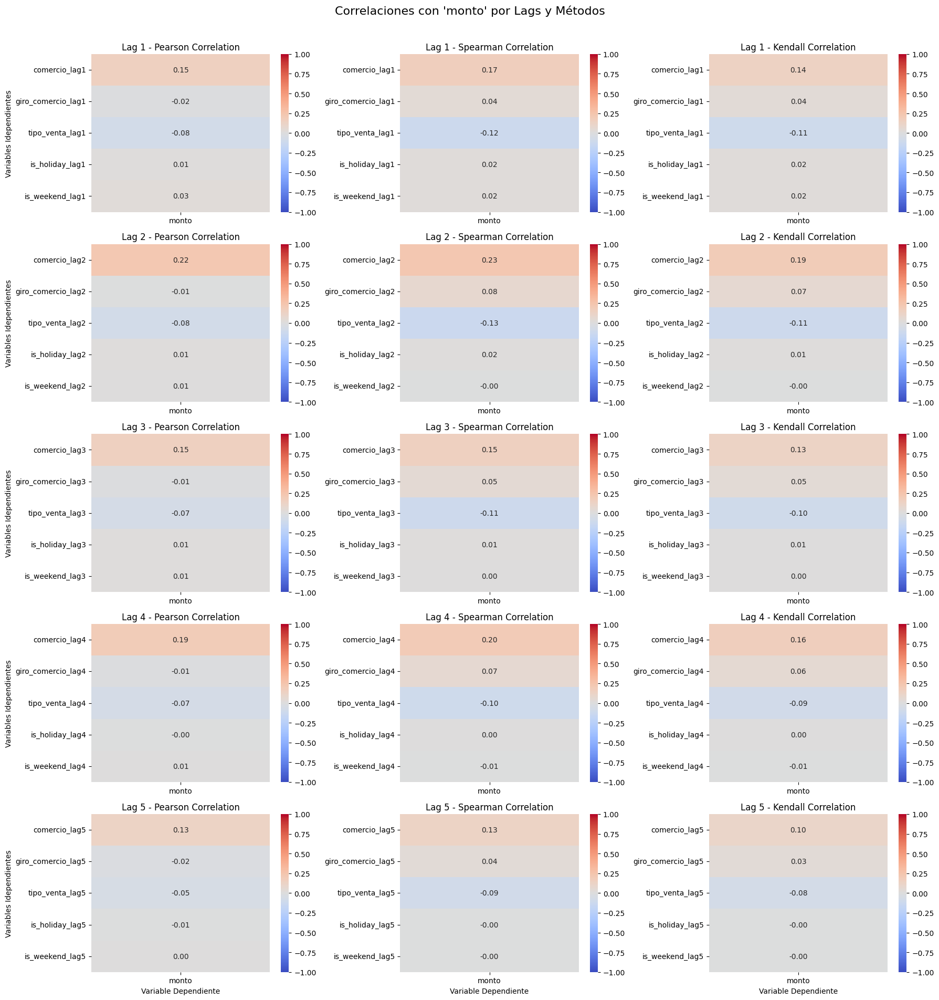

In [53]:
heat(df_mv, 'monto', 5)

### Seasonlaity

C:\Users\Juan Marco\AppData\Local\Temp\ipykernel_22752\2384233478.py:146: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


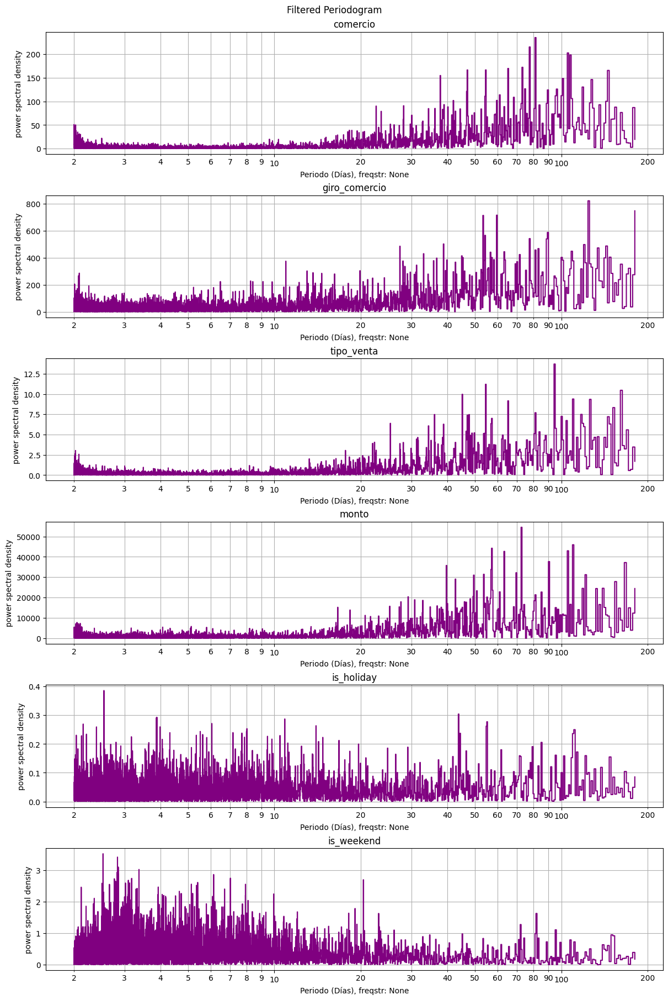

In [54]:
list_periods_spectra = Periodograma(df_mv, detrend='linear', window='boxcar', scaling='density', ts_frequency=None, show_minor_ticks=True, axsize=(12, 3))

In [56]:
graficar_serie_tiempo(df_mv, 'monto', ['is_holiday', 'is_weekend'])

# EDA: Exploratory Data Analysis

In [6]:
import matplotlib.pyplot as plt
import seaborn as sns

In [1]:
import pandas as pd
import numpy as np

# Cargar el archivo CSV 
df_clients = pd.read_csv('../data/raw/base_clientes_final.csv', parse_dates=['fecha_nacimiento', 'fecha_alta'])
df_clients.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 8 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   id                     1000 non-null   object        
 1   fecha_nacimiento       1000 non-null   datetime64[ns]
 2   fecha_alta             1000 non-null   datetime64[ns]
 3   id_municipio           1000 non-null   int64         
 4   id_estado              1000 non-null   int64         
 5   tipo_persona           1000 non-null   object        
 6   genero                 1000 non-null   object        
 7   actividad_empresarial  1000 non-null   object        
dtypes: datetime64[ns](2), int64(2), object(4)
memory usage: 62.6+ KB


In [2]:
# Cargar el archivo CSV usando la ruta absoluta
df_trans = pd.read_csv('../data/raw/base_transacciones_final.csv', parse_dates=['fecha'])
df_trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 346011 entries, 0 to 346010
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   id             346011 non-null  object        
 1   fecha          346011 non-null  datetime64[ns]
 2   comercio       346011 non-null  object        
 3   giro_comercio  340423 non-null  object        
 4   tipo_venta     346011 non-null  object        
 5   monto          346011 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(4)
memory usage: 15.8+ MB


In [3]:
# === FEATURE ENGINEERING CLIENTES ===
df_clients['fecha_nacimiento'] = pd.to_datetime(df_clients['fecha_nacimiento'], errors='coerce')
df_clients['fecha_alta'] = pd.to_datetime(df_clients['fecha_alta'], errors='coerce')

In [4]:
from dateutil.relativedelta import relativedelta

fecha_referencia = pd.Timestamp('2025-05-25')

# Calcular edad
df_clients['edad'] = df_clients['fecha_nacimiento'].apply(lambda x: relativedelta(fecha_referencia, x).years)

# Calcular antigüedad en años con decimales
df_clients['antiguedad'] = (fecha_referencia - df_clients['fecha_alta']).dt.days / 365.25

df_clients


,id,fecha_nacimiento,fecha_alta,id_municipio,id_estado,tipo_persona,genero,actividad_empresarial,edad,antiguedad
0,9980f12e32711330d5f58460e169e6207afda041,1984-06-19,2015-10-25,6822006,68,Persona Fisica Sin Actividad Empresarial,,EMPLEADO DEL SECTOR SERVICIOS,40,9.582478
1,93512ea145c3d81ba7a7ff641faf992fd307072e,1986-12-21,2018-02-11,6822014,68,Persona Fisica Con Actividad Empresarial,F,COMPRAVENTA DE ARTICULOS DE FERRETERIA,38,7.282683
2,acb2fee5aea2d73a88359d438aaedeea731554f8,1991-02-01,2019-05-12,6115121,61,Persona Fisica Con Actividad Empresarial,M,AGENCIA DE PUBLICIDAD,34,6.036961
3,b627227d2f20116510bcb12de34e6a188cf8d054,1994-05-23,2017-07-19,6923005,69,Persona Fisica Sin Actividad Empresarial,F,COMPRA VENTA DE ARTICULOS NO CLASIFICADOS EN O...,31,7.849418
4,054be5f40d50b28d2b82af57159343989dd28012,1990-10-03,2017-05-21,6014120,60,Persona Fisica Sin Actividad Empresarial,M,EMPLEADO DEL SECTOR SERVICIOS,34,8.010951
...,...,...,...,...,...,...,...,...,...,...
995,e14d88b8be5caa1af8ec5cf107335b28e2f7977b,1987-05-24,2018-11-11,6115095,61,Persona Fisica Sin Actividad Empresarial,M,DESPACHO DE OTROS PROFESIONISTAS,38,6.535250
996,44ea32e786c5b1a999f6421611776dc2d32df657,1993-08-15,2018-11-09,4701001,47,Persona Fisica Sin Actividad Empresarial,F,SERVICIOS MEDICO GENERAL Y ESPECIALIZADO EN CO...,31,6.540726
997,7bc502b1cf123d8cb1fc4cf945fa4de645757c06,1994-07-25,2018-11-09,6923004,69,Persona Fisica Sin Actividad Empresarial,M,PROFESIONISTA INDEPENDIENTE,30,6.540726
998,20c35f25b3b6227cbd5e2a34f6fa5e593bbf349e,1982-02-12,2018-11-05,5610007,56,Persona Fisica Sin Actividad Empresarial,M,ESTABLECIMIENTOS PUBLICOS DE INSTRUCCION EDUCA...,43,6.551677


## Insights

### Clientes

a) Distribución de edad

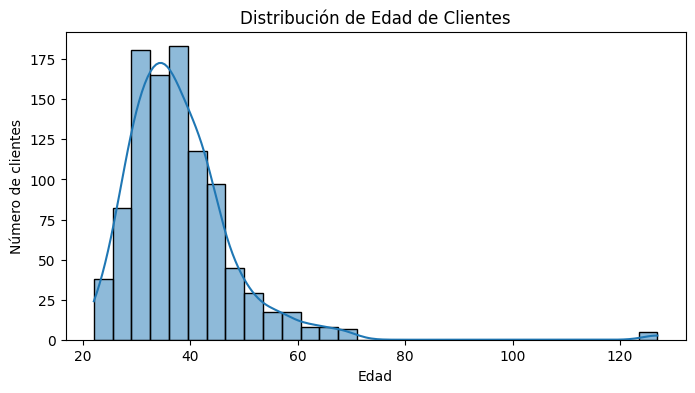

In [7]:
plt.figure(figsize=(8,4))
sns.histplot(df_clients['edad'], bins=30, kde=True)
plt.title("Distribución de Edad de Clientes")
plt.xlabel("Edad")
plt.ylabel("Número de clientes")
plt.show()

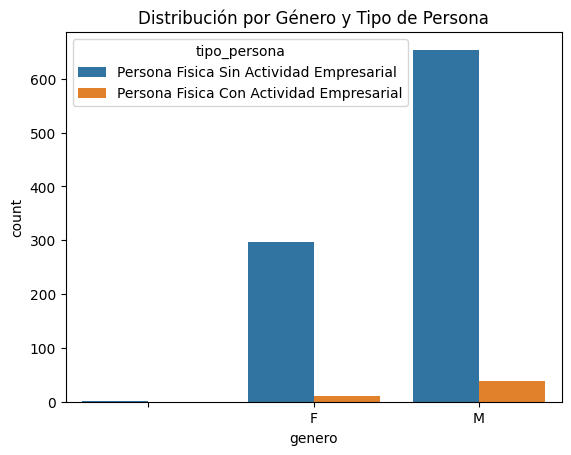

In [8]:
# b) Por género y tipo de persona
sns.countplot(data=df_clients, x='genero', hue='tipo_persona')
plt.title("Distribución por Género y Tipo de Persona")
plt.show()

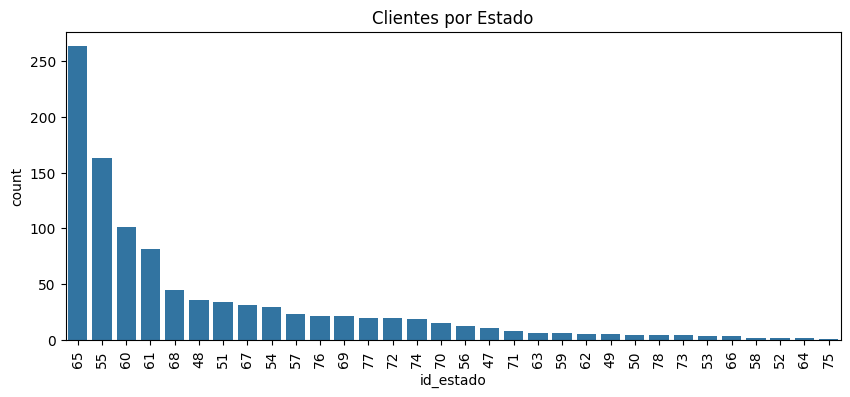

In [9]:
# c) Clientes por estado
plt.figure(figsize=(10,4))
sns.countplot(data=df_clients, x='id_estado', order=df_clients['id_estado'].value_counts().index)
plt.title("Clientes por Estado")
plt.xticks(rotation=90)
plt.show()

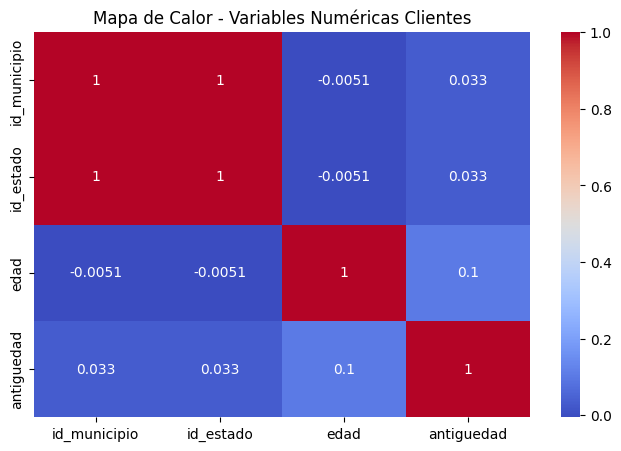

In [10]:
# d) Correlaciones
plt.figure(figsize=(8, 5))
sns.heatmap(df_clients.select_dtypes(include=[np.number]).corr(), annot=True, cmap='coolwarm')
plt.title("Mapa de Calor - Variables Numéricas Clientes")
plt.show()

### Transacciones

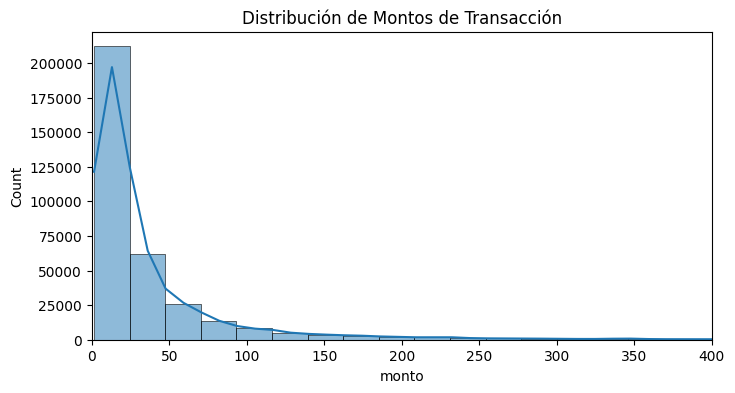

In [16]:
# a) Histograma de montos
plt.figure(figsize=(8, 4))
sns.histplot(df_trans['monto'], bins=100, kde=True)
plt.title("Distribución de Montos de Transacción")
plt.xlim(0, 400)
plt.show()

In [18]:
# b) Top giros y comercios
top_giros = df_trans['giro_comercio'].value_counts().head(10)
top_comercios = df_trans['comercio'].value_counts().head(10)

print("Top 10 giros:\n", top_giros)
print("\nTop 10 comercios:\n", top_comercios)

Top 10 giros:
 giro_comercio
AGREGADOR                                             56048
COMERCIOS ELECTRONICOS (VTAS POR INTERNET)            52829
TIENDAS DE CONVENIENCIA, MINISUPER                    42342
LIMOSINAS, (TAXIS)                                    33009
AUTOSERVICIOS Y SUPERMERCADOS                         18564
SERVICIOS DE TELECOMUNICACION, LLAMADAS LOC Y LARG    15191
PAGO DE SERVICIO POR TELEVISION CABLE/POR EVENTO      14986
COMIDA RAPIDA                                         14292
TRASLADOS - FLETES, (SERVICIOS DE MENSAJERIA)         12892
DROGUERIAS, (FARMACIAS)                               10598
Name: count, dtype: int64

Top 10 comercios:
 comercio
UBER                     40263
AMAZON                   38600
OXXO                     29607
UBER EATS                15228
MERCADO PAGO             14501
RAPPI                    12070
DIDI RIDES               11195
7 ELEVEN                 10431
TELCEL                   10036
FARMACIAS GUADALAJARA     6987
Name: 

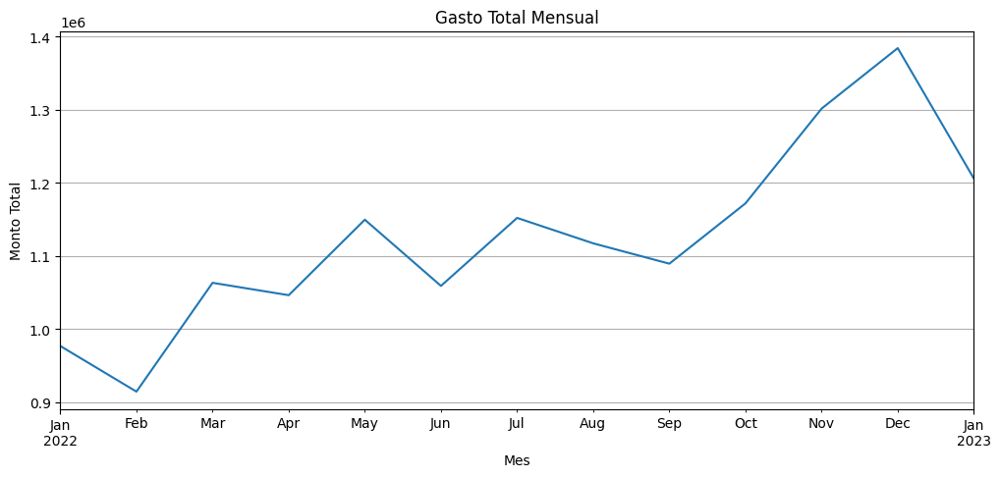

In [19]:
# c) Transacciones por mes
df_trans['mes'] = df_trans['fecha'].dt.to_period('M').dt.to_timestamp()
monthly_volume = df_trans.groupby('mes')['monto'].sum()

monthly_volume.plot(figsize=(12,5))
plt.title("Gasto Total Mensual")
plt.ylabel("Monto Total")
plt.xlabel("Mes")
plt.grid()
plt.show()

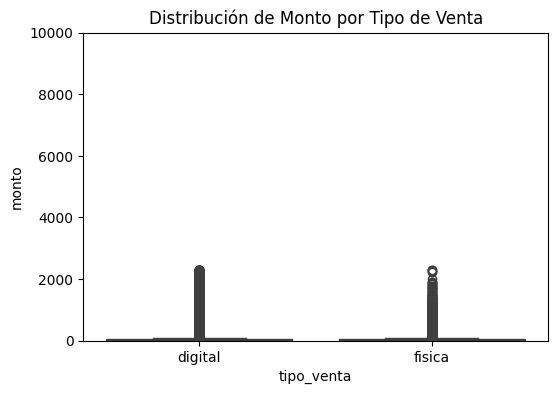

In [20]:
# d) Comparación por tipo de venta
plt.figure(figsize=(6, 4))
sns.boxplot(data=df_trans, x='tipo_venta', y='monto')
plt.title("Distribución de Monto por Tipo de Venta")
plt.ylim(0, 10000)
plt.show()

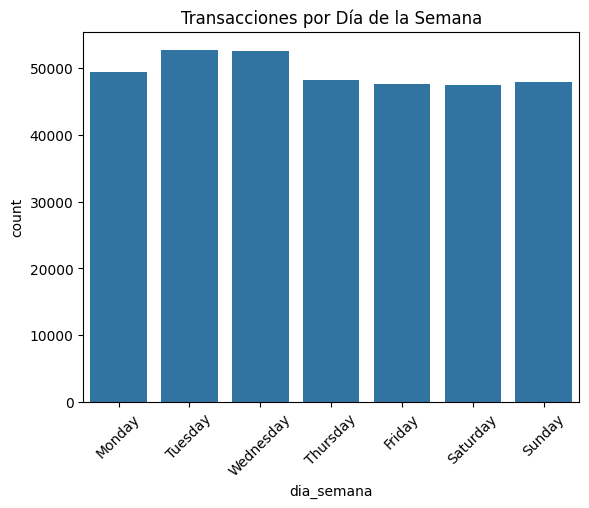

In [21]:
# e) Días más activos
df_trans['dia_semana'] = df_trans['fecha'].dt.day_name()
sns.countplot(data=df_trans, x='dia_semana', order=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title("Transacciones por Día de la Semana")
plt.xticks(rotation=45)
plt.show()

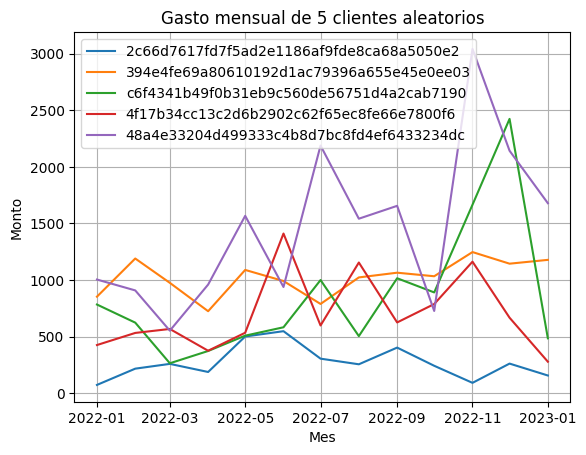

In [22]:
# === 3. ANÁLISIS TEMPORAL POR CLIENTE ===
client_monthly = df_trans.groupby(['id', 'mes'])['monto'].sum().reset_index()

# Muestra de 5 clientes
sample_ids = df_clients['id'].sample(5, random_state=42)
for cid in sample_ids:
    client_data = client_monthly[client_monthly['id'] == cid]
    plt.plot(client_data['mes'], client_data['monto'], label=cid)

plt.legend()
plt.title("Gasto mensual de 5 clientes aleatorios")
plt.xlabel("Mes")
plt.ylabel("Monto")
plt.grid()
plt.show()

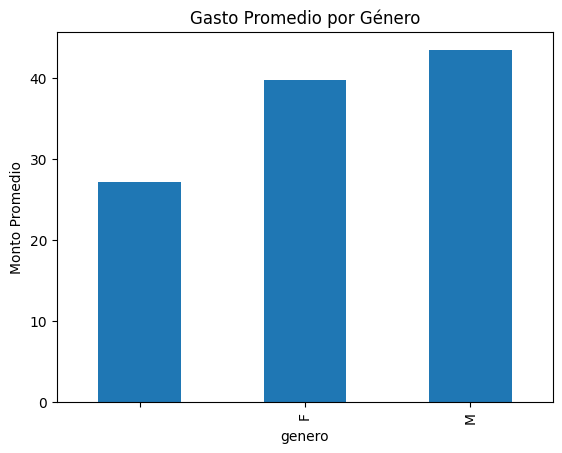

In [24]:
# === 4. GASTO VS ATRIBUTOS CLIENTE ===

# Unir info de clientes y transacciones
df_all = df_trans.merge(df_clients, on='id')

# a) Gasto promedio por género
gender_spending = df_all.groupby('genero')['monto'].mean()
gender_spending.plot(kind='bar', title="Gasto Promedio por Género")
plt.ylabel("Monto Promedio")
plt.show()

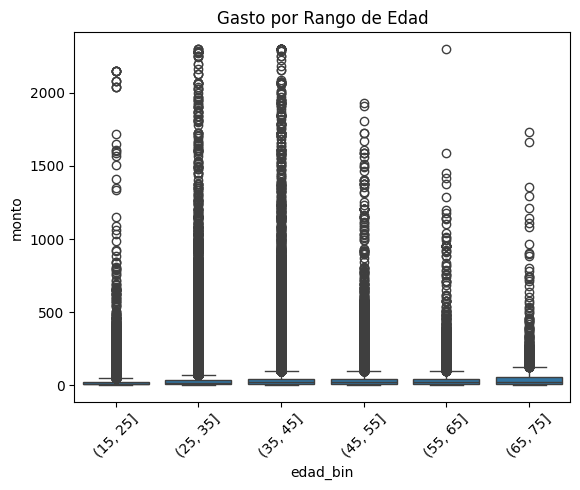

In [25]:
# b) Gasto promedio por edad (bins)
df_all['edad_bin'] = pd.cut(df_all['edad'], bins=[15,25,35,45,55,65,75])
sns.boxplot(data=df_all, x='edad_bin', y='monto')
plt.title("Gasto por Rango de Edad")
plt.xticks(rotation=45)
plt.show()

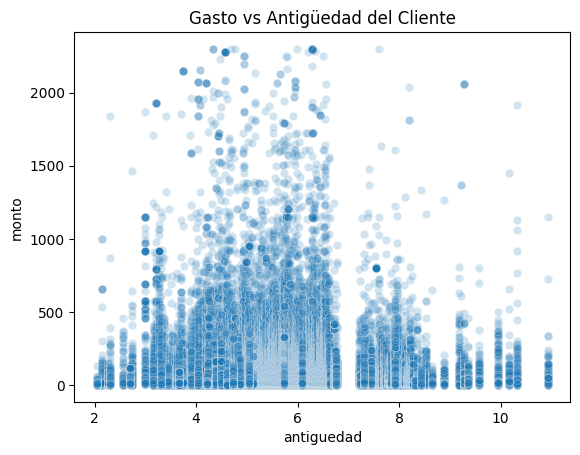

In [ ]:
# c) Gasto por antigüedad
sns.scatterplot(data=df_all, x='antiguedad', y='monto', alpha=0.2)
plt.title("Gasto vs Antigüedad del Cliente")
plt.show()

# Con seasborn

In [27]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Estilo para gráficas
sns.set(style='whitegrid')


In [28]:
# Cargar el archivo CSV 
df_clients = pd.read_csv('../data/raw/base_clientes_final.csv', parse_dates=['fecha_nacimiento', 'fecha_alta'])

In [29]:
df_tx = pd.read_csv('../data/raw/base_transacciones_final.csv', parse_dates=['fecha'])

In [30]:
# === FEATURE ENGINEERING CLIENTES ===
df_clients['fecha_nacimiento'] = pd.to_datetime(df_clients['fecha_nacimiento'], errors='coerce')
df_clients['fecha_alta'] = pd.to_datetime(df_clients['fecha_alta'], errors='coerce')

In [31]:
from dateutil.relativedelta import relativedelta

fecha_referencia = pd.Timestamp('2025-05-25')

# Calcular edad
df_clients['edad'] = df_clients['fecha_nacimiento'].apply(lambda x: relativedelta(fecha_referencia, x).years)

# Calcular antigüedad en años con decimales
df_clients['antiguedad'] = (fecha_referencia - df_clients['fecha_alta']).dt.days / 365.25

In [32]:
# Mes de transacción
df_tx['mes'] = df_tx['fecha'].dt.to_period("M").astype(str)

# Total mensual por cliente
df_monthly = df_tx.groupby(['id', 'mes'])['monto'].sum().reset_index(name='monto_mensual')

# Frecuencia mensual de transacciones
df_freq = df_tx.groupby(['id', 'mes'])['fecha'].count().reset_index(name='frecuencia')

## Univariado

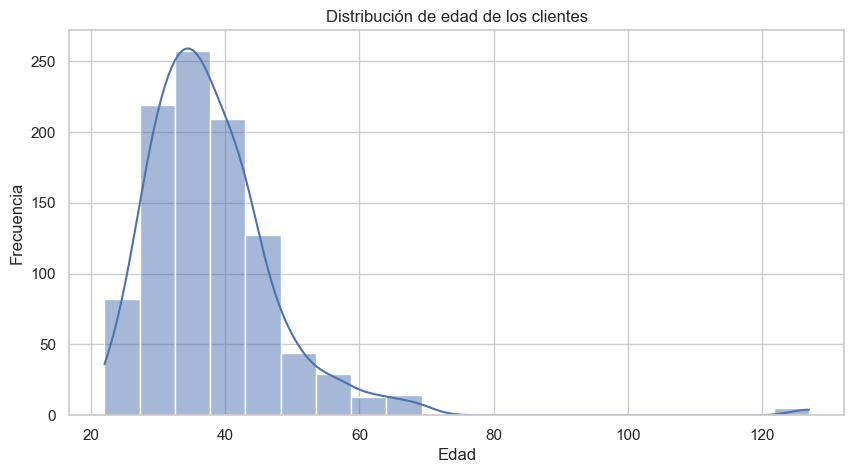

In [33]:
plt.figure(figsize=(10,5))
sns.histplot(df_clients['edad'], bins=20, kde=True)
plt.title('Distribución de edad de los clientes')
plt.xlabel('Edad')
plt.ylabel('Frecuencia')
plt.show()


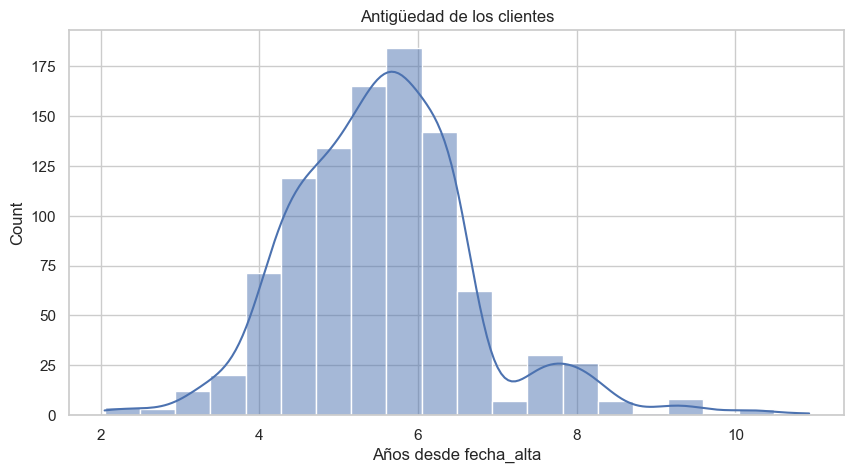

In [34]:
plt.figure(figsize=(10,5))
sns.histplot(df_clients['antiguedad'], bins=20, kde=True)
plt.title('Antigüedad de los clientes')
plt.xlabel('Años desde fecha_alta')
plt.show()


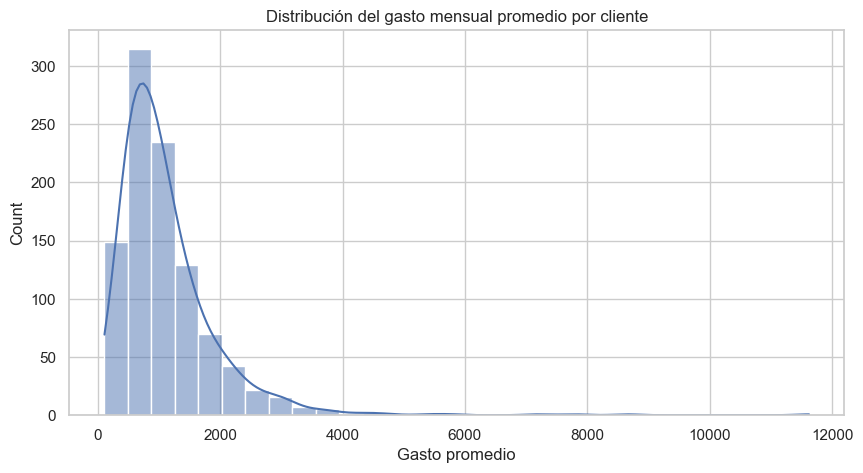

In [35]:
gasto_promedio = df_monthly.groupby('id')['monto_mensual'].mean().reset_index(name='gasto_promedio')
plt.figure(figsize=(10,5))
sns.histplot(gasto_promedio['gasto_promedio'], bins=30, kde=True)
plt.title('Distribución del gasto mensual promedio por cliente')
plt.xlabel('Gasto promedio')
plt.show()


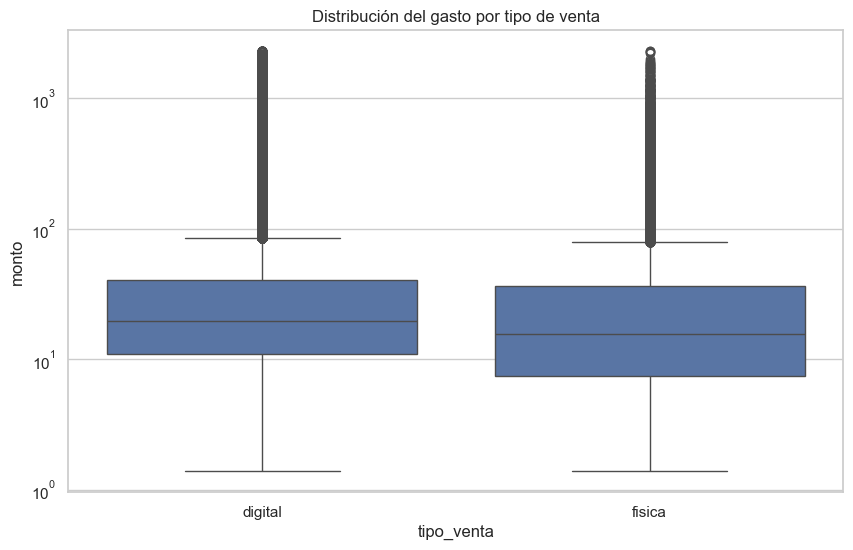

In [36]:
plt.figure(figsize=(10,6))
sns.boxplot(data=df_tx, x='tipo_venta', y='monto')
plt.yscale('log')
plt.title('Distribución del gasto por tipo de venta')
plt.show()


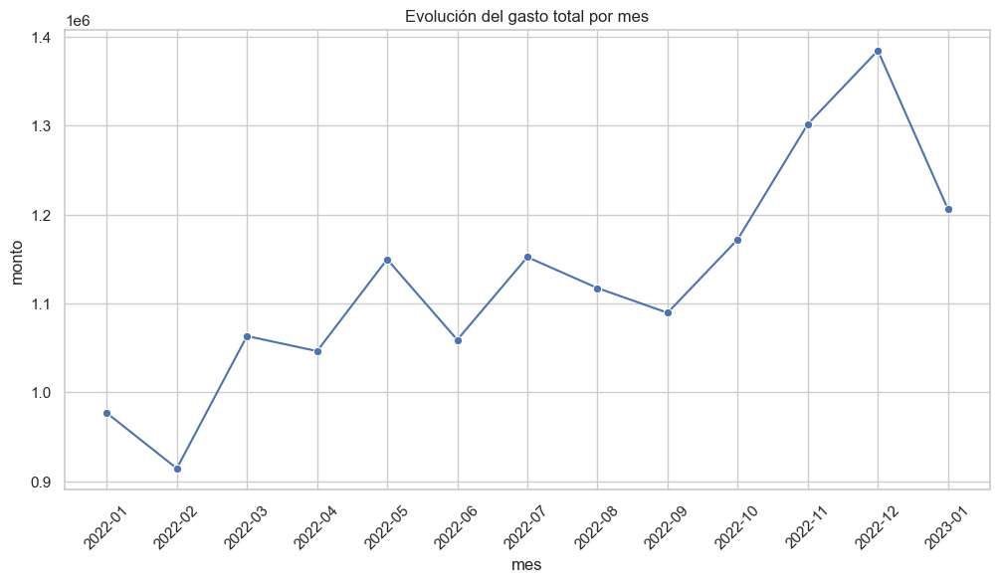

In [37]:
gasto_total_mensual = df_tx.groupby('mes')['monto'].sum().reset_index()
plt.figure(figsize=(12,6))
sns.lineplot(data=gasto_total_mensual, x='mes', y='monto', marker='o')
plt.title('Evolución del gasto total por mes')
plt.xticks(rotation=45)
plt.show()


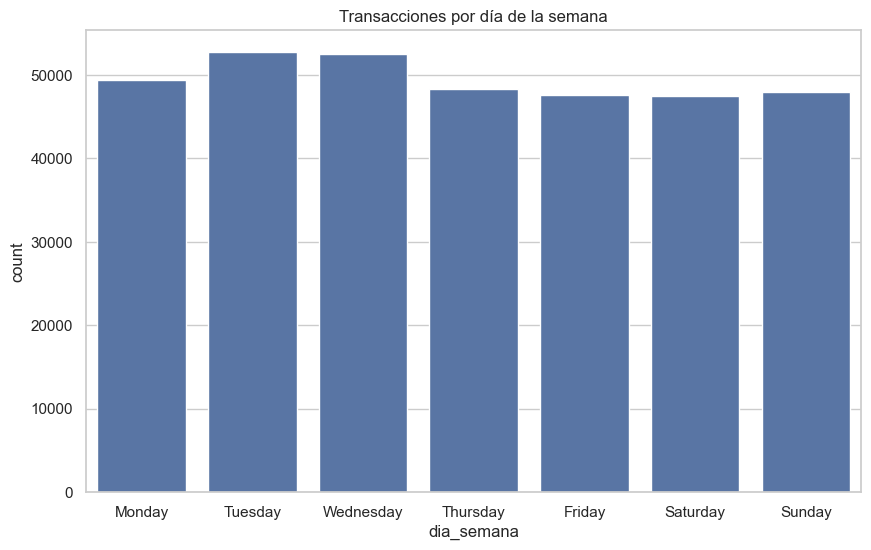

In [38]:
df_tx['dia_semana'] = df_tx['fecha'].dt.day_name()
orden_dias = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

plt.figure(figsize=(10,6))
sns.countplot(data=df_tx, x='dia_semana', order=orden_dias)
plt.title('Transacciones por día de la semana')
plt.show()


## Multivariado

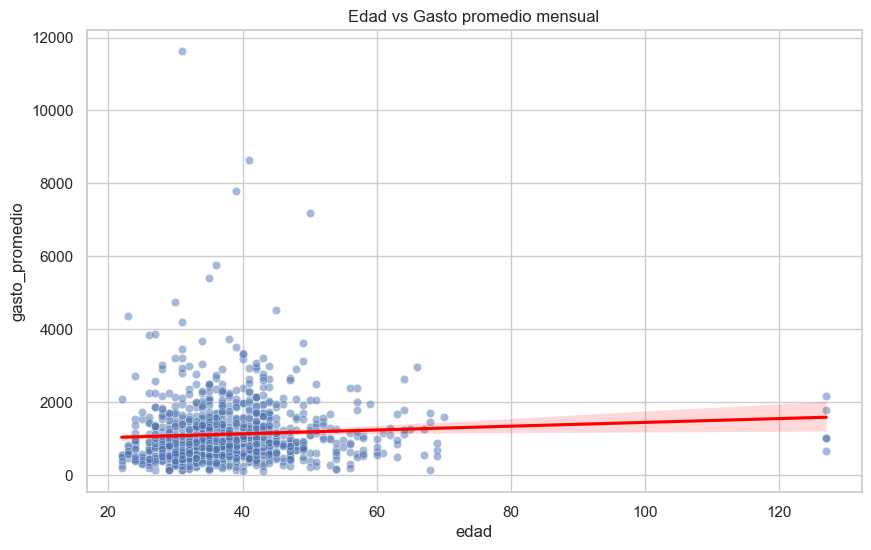

In [39]:
df_edad_gasto = gasto_promedio.merge(df_clients[['id', 'edad']], on='id')

plt.figure(figsize=(10,6))
sns.scatterplot(data=df_edad_gasto, x='edad', y='gasto_promedio', alpha=0.5)
sns.regplot(data=df_edad_gasto, x='edad', y='gasto_promedio', scatter=False, color='red')
plt.title('Edad vs Gasto promedio mensual')
plt.show()


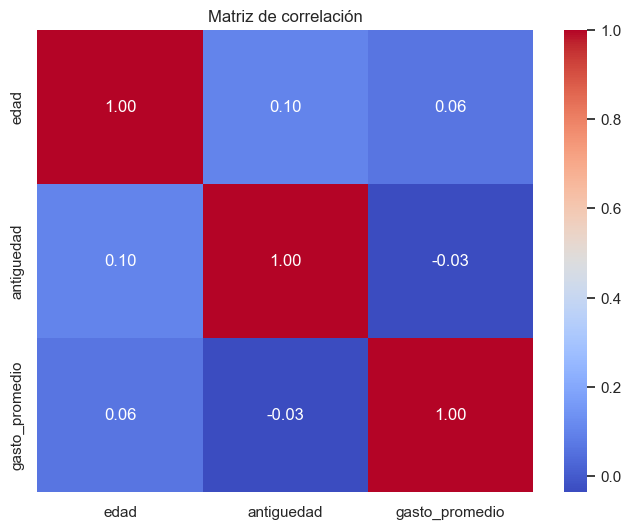

In [40]:
# Agregamos más features para el heatmap
df_feat = df_clients[['id', 'edad', 'antiguedad']].merge(gasto_promedio, on='id')
corr = df_feat.drop('id', axis=1).corr()

plt.figure(figsize=(8,6))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriz de correlación')
plt.show()


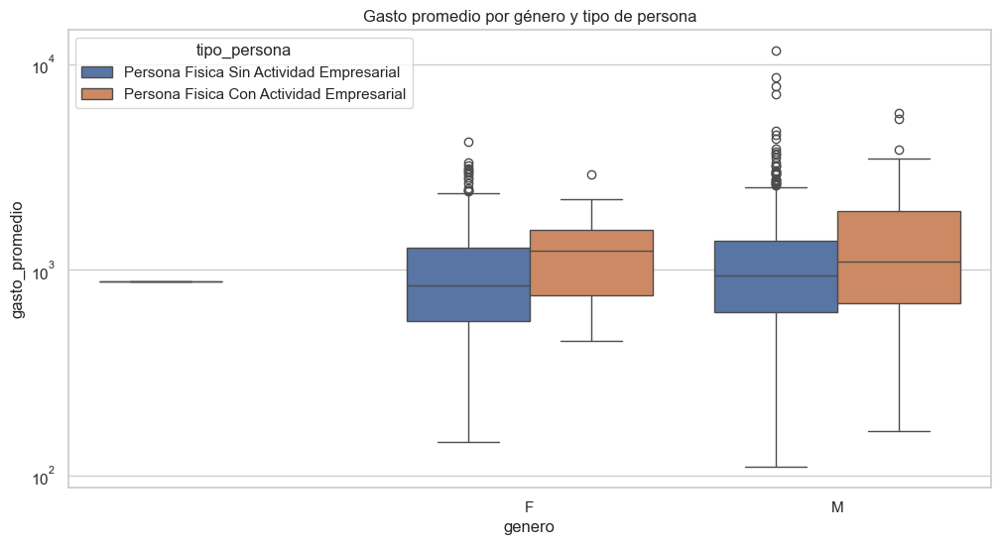

In [41]:
df_comb = df_clients[['id', 'genero', 'tipo_persona']].merge(gasto_promedio, on='id')

plt.figure(figsize=(12,6))
sns.boxplot(data=df_comb, x='genero', y='gasto_promedio', hue='tipo_persona')
plt.yscale('log')
plt.title('Gasto promedio por género y tipo de persona')
plt.show()


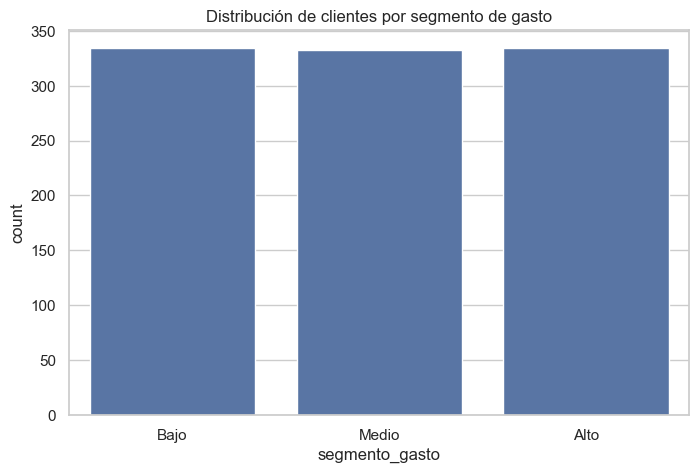

In [42]:
df_clients['segmento_gasto'] = pd.qcut(gasto_promedio['gasto_promedio'], q=3, labels=['Bajo', 'Medio', 'Alto'])

plt.figure(figsize=(8,5))
sns.countplot(x=df_clients['segmento_gasto'])
plt.title("Distribución de clientes por segmento de gasto")
plt.show()


# Con plotly

In [42]:
import pandas as pd

# Cargar el archivo CSV 
df_clients = pd.read_csv('../data/raw/base_clientes_final.csv', parse_dates=['fecha_nacimiento', 'fecha_alta'])
df_tx = pd.read_csv('../data/raw/base_transacciones_final.csv', parse_dates=['fecha'])

In [43]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

# ========== FEATURE ENGINEERING ==========
fecha_referencia = pd.Timestamp('2023-01-01')
df_clients['edad'] = df_clients['fecha_nacimiento'].apply(lambda x: fecha_referencia.year - x.year - ((fecha_referencia.month, fecha_referencia.day) < (x.month, x.day)))
df_clients['antiguedad'] = (fecha_referencia - df_clients['fecha_alta']).dt.days / 365.25

df_tx['mes'] = df_tx['fecha'].dt.to_period('M').astype(str)
df_tx['dia_semana'] = df_tx['fecha'].dt.day_name()

## Univariado

In [5]:
# ========== ANÁLISIS UNIVARIADO ==========
# Distribución de edades
fig = px.histogram(df_clients, x='edad', nbins=30, title='Distribución de edades')
fig.show()

In [6]:
# Distribución de antigüedad
fig = px.histogram(df_clients, x='antiguedad', nbins=30, title='Distribución de antigüedad como cliente (años)')
fig.show()

In [7]:
# Género
fig = px.pie(df_clients, names='genero', title='Distribución por género')
fig.show()

In [8]:
# Tipo de persona
fig = px.pie(df_clients, names='tipo_persona', title='Tipo de persona')
fig.show()

In [10]:
# Actividad empresarial
fig = px.pie(df_clients, names='actividad_empresarial', title='¿Tiene actividad empresarial?')
fig.show()

### Transacciones

In [11]:
# Monto por transacción
fig = px.histogram(df_tx, x='monto', nbins=100, title='Distribución de montos por transacción')
fig.show()

In [12]:
# Gasto total por mes
gasto_mensual = df_tx.groupby('mes')['monto'].sum().reset_index()
fig = px.line(gasto_mensual, x='mes', y='monto', title='Gasto total mensual', markers=True)
fig.update_layout(xaxis_tickangle=-45)
fig.show()

In [13]:
# Transacciones por día de la semana
fig = px.histogram(df_tx, x='dia_semana', title='Transacciones por día de la semana')
fig.update_xaxes(categoryorder='array', categoryarray=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
fig.show()

In [46]:
fig = px.pie(df_tx, names='comercio', title='Distribución por comercio')
fig.show()

In [14]:
# Tipo de venta
fig = px.pie(df_tx, names='tipo_venta', title='Distribución por tipo de venta')
fig.show()

In [44]:
# Giro de comercio más frecuente
fig = px.histogram(df_tx, x='giro_comercio', title='Transacciones por giro de comercio')
#fig.update_xaxes(tickangle=45)
fig.show()

## Bivariado

In [17]:
# Edad vs gasto total
gasto_por_cliente = df_tx.groupby('id')['monto'].sum().reset_index().rename(columns={'monto': 'gasto_total'})
df_merged = df_clients.merge(gasto_por_cliente, on='id', how='left')

fig = px.scatter(df_merged, x='edad', y='gasto_total', title='Edad vs Gasto Total')
fig.show()

In [18]:
# Antigüedad vs gasto total
fig = px.scatter(df_merged, x='antiguedad', y='gasto_total', title='Antigüedad vs Gasto Total')
fig.show()

In [19]:
# Gasto medio mensual por cliente
gasto_mensual_cliente = df_tx.groupby(['id', 'mes'])['monto'].sum().reset_index()
gasto_promedio_cliente = gasto_mensual_cliente.groupby('id')['monto'].mean().reset_index(name='promedio_mensual')
df_merged = df_merged.merge(gasto_promedio_cliente, on='id', how='left')

fig = px.histogram(df_merged, x='promedio_mensual', nbins=50, title='Promedio mensual de gasto por cliente')
fig.show()

## Multivariado

In [20]:
# Relación entre edad, antigüedad y gasto
fig = px.scatter_3d(df_merged, x='edad', y='antiguedad', z='gasto_total',
                    color='genero', title='Edad vs Antigüedad vs Gasto Total (color por género)')
fig.show()

In [21]:
# Boxplot de gasto por género
fig = px.box(df_merged, x='genero', y='gasto_total', title='Distribución de gasto total por género')
fig.show()

In [ ]:
# Boxplot por actividad empresarial
fig = px.box(df_merged, x='actividad_empresarial', y='gasto_total', title='Gasto por actividad empresarial')
fig.show()

# Exploración mas especifica

In [ ]:
import pandas as pd
import plotly.express as px
from ipywidgets import interact, widgets

# Asegúrate de que tu DataFrame tenga estas columnas
df_tx['fecha'] = pd.to_datetime(df_tx['fecha'])

# Lista única de clientes
clientes = sorted(df_tx['id'].unique())

# Función para graficar los gastos de un cliente
def mostrar_gasto(cliente_id):
    df_cliente = df_tx[df_tx['id'] == cliente_id]

    if df_cliente.empty:
        print("Cliente sin datos")
        return

    # Serie de tiempo
    df_serie = df_cliente.groupby('fecha')['monto'].sum().reset_index()
    fig1 = px.line(df_serie, x='fecha', y='monto',
                   title=f'Serie de tiempo: Gasto del cliente {cliente_id}')
    fig1.show()

    # Gasto por giro
    df_giro = df_cliente.groupby('giro_comercio')['monto'].sum().reset_index().sort_values('monto', ascending=False)
    fig2 = px.bar(df_giro, x='giro_comercio', y='monto',
                  title=f'Gasto por giro de comercio: Cliente {cliente_id}')
    fig2.show()

# Widget interactivo
interact(mostrar_gasto, cliente_id=widgets.Dropdown(options=clientes, description="Cliente ID:"))


interactive(children=(Dropdown(description='Cliente ID:', options=('003d9abe467a91847d566cf455bd2d7d6c8f7e75',…

<function __main__.mostrar_gasto(cliente_id)>

# Limpieza y exportación

## BD Clients

In [3]:
# Checar si hay nulos en cualquier columna de df_clients
df_clients.isnull().sum()

id                       0
fecha_nacimiento         0
fecha_alta               0
id_municipio             0
id_estado                0
tipo_persona             0
genero                   0
actividad_empresarial    0
dtype: int64

In [4]:
import pandas as pd
import numpy as np

duplicados_clients = df_clients[df_clients.duplicated(subset='id', keep=False)]
if not duplicados_clients.empty:
    print("Clientes duplicados encontrados:")
    print(duplicados_clients)

In [6]:
# 2. Valores nulos
print("Nulos en CLIENTES:\n", df_clients.isnull().sum())

# No hay nulos graves, pero podemos revisar valores inconsistentes:
# Edad negativa o futura
today = pd.Timestamp("2025-05-25")
df_clients = df_clients[df_clients['fecha_nacimiento'] <= today]
df_clients = df_clients[df_clients['fecha_alta'] <= today]

# 3. Crear edad y antigüedad
df_clients['edad'] = ((today - df_clients['fecha_nacimiento']).dt.days / 365.25).astype(int)
df_clients['antiguedad'] = ((today - df_clients['fecha_alta']).dt.days / 365.25).round(1)

# Tipo persona, género y actividad: llenar con "Desconocido" si faltara
cat_cols = ['tipo_persona', 'genero', 'actividad_empresarial']
for col in cat_cols:
    df_clients[col] = df_clients[col].fillna("Desconocido")

Nulos en CLIENTES:
 id                       0
fecha_nacimiento         0
fecha_alta               0
id_municipio             0
id_estado                0
tipo_persona             0
genero                   0
actividad_empresarial    0
dtype: int64


In [15]:
df_clients

,id,fecha_nacimiento,fecha_alta,id_municipio,id_estado,tipo_persona,genero,actividad_empresarial,edad,antiguedad
0,9980f12e32711330d5f58460e169e6207afda041,1984-06-19,2015-10-25,6822006,68,Persona Fisica Sin Actividad Empresarial,,EMPLEADO DEL SECTOR SERVICIOS,40,9.6
1,93512ea145c3d81ba7a7ff641faf992fd307072e,1986-12-21,2018-02-11,6822014,68,Persona Fisica Con Actividad Empresarial,F,COMPRAVENTA DE ARTICULOS DE FERRETERIA,38,7.3
2,acb2fee5aea2d73a88359d438aaedeea731554f8,1991-02-01,2019-05-12,6115121,61,Persona Fisica Con Actividad Empresarial,M,AGENCIA DE PUBLICIDAD,34,6.0
3,b627227d2f20116510bcb12de34e6a188cf8d054,1994-05-23,2017-07-19,6923005,69,Persona Fisica Sin Actividad Empresarial,F,COMPRA VENTA DE ARTICULOS NO CLASIFICADOS EN O...,31,7.8
4,054be5f40d50b28d2b82af57159343989dd28012,1990-10-03,2017-05-21,6014120,60,Persona Fisica Sin Actividad Empresarial,M,EMPLEADO DEL SECTOR SERVICIOS,34,8.0
...,...,...,...,...,...,...,...,...,...,...
995,e14d88b8be5caa1af8ec5cf107335b28e2f7977b,1987-05-24,2018-11-11,6115095,61,Persona Fisica Sin Actividad Empresarial,M,DESPACHO DE OTROS PROFESIONISTAS,38,6.5
996,44ea32e786c5b1a999f6421611776dc2d32df657,1993-08-15,2018-11-09,4701001,47,Persona Fisica Sin Actividad Empresarial,F,SERVICIOS MEDICO GENERAL Y ESPECIALIZADO EN CO...,31,6.5
997,7bc502b1cf123d8cb1fc4cf945fa4de645757c06,1994-07-25,2018-11-09,6923004,69,Persona Fisica Sin Actividad Empresarial,M,PROFESIONISTA INDEPENDIENTE,30,6.5
998,20c35f25b3b6227cbd5e2a34f6fa5e593bbf349e,1982-02-12,2018-11-05,5610007,56,Persona Fisica Sin Actividad Empresarial,M,ESTABLECIMIENTOS PUBLICOS DE INSTRUCCION EDUCA...,43,6.6


In [ ]:
# La que no tiene genero
df_clients[df_clients['id'].astype(str).str.contains('9980f12e32711330d5f58460e169e6207afda041')]

,id,fecha_nacimiento,fecha_alta,id_municipio,id_estado,tipo_persona,genero,actividad_empresarial,edad,antiguedad
0,9980f12e32711330d5f58460e169e6207afda041,1984-06-19,2015-10-25,6822006,68,Persona Fisica Sin Actividad Empresarial,,EMPLEADO DEL SECTOR SERVICIOS,40,9.6


In [17]:
df_tx[df_tx['id'].astype(str).str.contains('9980f12e32711330d5f58460e169e6207afda041')]

,id,fecha,comercio,giro_comercio,tipo_venta,monto
2208,9980f12e32711330d5f58460e169e6207afda041,2022-01-02,COPPEL,TIENDA DEPARTAMENTAL,digital,131.90
2209,9980f12e32711330d5f58460e169e6207afda041,2022-01-02,AMAZON,COMERCIOS ELECTRONICOS (VTAS POR INTERNET),digital,2.54
2210,9980f12e32711330d5f58460e169e6207afda041,2022-01-02,AMAZON,COMERCIOS ELECTRONICOS (VTAS POR INTERNET),digital,47.80
2211,9980f12e32711330d5f58460e169e6207afda041,2022-01-02,OXXO,"TIENDAS DE CONVENIENCIA, MINISUPER",fisica,17.01
2212,9980f12e32711330d5f58460e169e6207afda041,2022-01-04,OXXO,"TIENDAS DE CONVENIENCIA, MINISUPER",fisica,6.44
...,...,...,...,...,...,...
2623,9980f12e32711330d5f58460e169e6207afda041,2023-01-26,FARMACIAS GUADALAJARA,"DROGUERIAS, (FARMACIAS)",fisica,14.03
2624,9980f12e32711330d5f58460e169e6207afda041,2023-01-26,FARMACIAS GUADALAJARA,"DROGUERIAS, (FARMACIAS)",fisica,2.88
2625,9980f12e32711330d5f58460e169e6207afda041,2023-01-27,UBER,AGREGADOR,digital,14.32
2626,9980f12e32711330d5f58460e169e6207afda041,2023-01-27,OXXO,"TIENDAS DE CONVENIENCIA, MINISUPER",fisica,7.71


In [18]:
# Eliminar filas que tengan el id de la persona sin género
df_clients = df_clients[~df_clients['id'].astype(str).str.contains('9980f12e32711330d5f58460e169e6207afda041')]
df_clients = df_clients.reset_index(drop=True)

df_tx = df_tx[~df_tx['id'].astype(str).str.contains('9980f12e32711330d5f58460e169e6207afda041')]
df_tx = df_tx.reset_index(drop=True)

df_clients['genero'].value_counts()

genero
M    693
F    306
Name: count, dtype: int64

## BD Transacciones

In [19]:
# Checar si hay nulos en cualquier columna de df_tx
df_tx.isnull().sum()

id                  0
fecha               0
comercio            0
giro_comercio    5588
tipo_venta          0
monto               0
dtype: int64

In [34]:
# giro_comercio tiene nulos, los rellenamos con 'No especificado'
df_tx['giro_comercio'] = df_tx['giro_comercio'].fillna('No especificado')
df_tx.isnull().sum()

id               0
fecha            0
comercio         0
giro_comercio    0
tipo_venta       0
monto            0
dtype: int64

In [35]:
df_tx.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 345591 entries, 0 to 345590
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   id             345591 non-null  object        
 1   fecha          345591 non-null  datetime64[ns]
 2   comercio       345591 non-null  object        
 3   giro_comercio  345591 non-null  object        
 4   tipo_venta     345591 non-null  object        
 5   monto          345591 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(4)
memory usage: 15.8+ MB


In [36]:
# Imprimir si existen montos negativos
if (df_tx['monto'] < 0).any():
    print("Existen montos negativos en las transacciones.")
df_tx = df_tx[df_tx['monto'] > 0]

In [37]:
# Mostrar los outliers en df_tx
df_tx['monto'].describe()

count    345591.000000
mean         42.309118
std          94.606976
min           1.390000
25%           9.320000
50%          17.930000
75%          39.430000
max        2297.880000
Name: monto, dtype: float64

In [38]:
# 5. Validar que todos los ID estén en clientes
df_tx = df_tx[df_tx['id'].isin(df_clients['id'])]

In [39]:
df_tx.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 345591 entries, 0 to 345590
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   id             345591 non-null  object        
 1   fecha          345591 non-null  datetime64[ns]
 2   comercio       345591 non-null  object        
 3   giro_comercio  345591 non-null  object        
 4   tipo_venta     345591 non-null  object        
 5   monto          345591 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(4)
memory usage: 15.8+ MB


In [40]:
# === EXPORTAR ARCHIVOS LIMPIOS ===

df_clients.to_csv("Cleaned_ClientData.csv", index=False)
df_tx.to_csv("Cleaned_TransactionData.csv", index=False)
